# 当モデルの説明: CircleModel1

- サークルグラフを考える。
- 各世代ごとにノードiのリソースが最大となり、ノード mod(i + N/2, N) のリソースが最小となる。
- 各ノードは隣接ノードの一つとゲームを行う。
    - C: 自分のリソースのrを拠出し、プール財をb倍して均等配分。
    - D: 自分はリソースを拠出せず、プール財をb倍して均等配分。
- リソースが少なすぎると死ぬ。
- リソースが豊かな個体は死んだノードに子を生む。
- i が激しく変動する場合、集団全体が協力的、かつ、平均距離が短いほうが良い。

リソースリッチなノードが固定的な場合は、リソースリッチなノードをハブとしてスケールフリー的なネットワークが構成され、協力が進化する。

リソースリッチなノードが変動する場合は、ハブが形成されずランダムネットワークが構成され、協力が進化しない。

# 次のモデルの説明: CircleModel2

変動性がある場合の方が、協力が進化するようにするにはどうすれば良いか？

ある一定のリソース以下のエージェントは全部死ぬようにすればよいのでは？そうすると、孤立ノードや協力しないノードは全部死んで、突然変異が起こりやすくなる。

# Model

In [1]:
using StatsBase: mean, std, shuffle, sample, Weights, countmap
using Parameters
using Random: MersenneTwister

using Graphs

using Colors
using Plots
using GraphPlot

using Test: @testset, @test

println("Julia $(VERSION)")
println("Thread count: $(Threads.nthreads())")

Julia 1.10.2
Thread count: 12


In [2]:
# color scheme
const DARK_BLUE = colorant"#2D579A"
const LIGHT_BLUE = colorant"#9BADCB"
const DARK_RED = colorant"#B32034"
const LIGHT_RED = colorant"#DBBEC1"
const GRAY = colorant"#E3E3E3"
const COLOR_GRAD = cgrad([DARK_RED, GRAY, DARK_BLUE], [0.0, 0.5, 1.0])

[DARK_RED, LIGHT_RED, GRAY, LIGHT_BLUE, DARK_BLUE] |> display
COLOR_GRAD |> display

## Network

In [3]:
average_degree(g::SimpleGraph)::Float64 = 2 * ne(g) / nv(g)

function average_distance(g::SimpleGraph)::Float64
    n = nv(g)
    shortest_paths = floyd_warshall_shortest_paths(g).dists
    shortest_paths = [path for path in shortest_paths if 0 < path < n]
    total_distance = sum(shortest_paths)
    combinations = length(shortest_paths)
    
    if total_distance < 0
        display(shortest_paths)
        @show minimum(shortest_paths)
        @show maximum(shortest_paths)
    end

    return total_distance / combinations
end

function desc(g::SimpleGraph)::Nothing
    println("Average Degree (k̄):\t $(average_degree(g))")
    println("Average Distance (L):\t $(average_distance(g))")
    println("Average Clustering Coefficient (C):\t $(global_clustering_coefficient(g))")
end

function create_cycle_graph(N::Int, k::Int, initial_w::Float64 = 1.0)::SimpleGraph
    @assert N > k > 1 && N % 2 == 0 && k % 2 == 0

    adjacency_matrix = zeros(Float16, N, N)

    for y = 1:N
        for offset = 1:(k ÷ 2)
            x = mod(y + offset - 1, N) + 1
            adjacency_matrix[y, x] = initial_w

            x = mod(y - offset - 1, N) + 1
            adjacency_matrix[y, x] = initial_w
        end
    end

    return SimpleGraph(adjacency_matrix)
end

N = 10
g = create_cycle_graph(N, 4)
desc(g)

Average Degree (k̄):	 4.0
Average Distance (L):	 1.6666666666666667
Average Clustering Coefficient (C):	 0.5


## Model structure

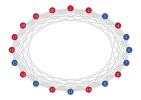

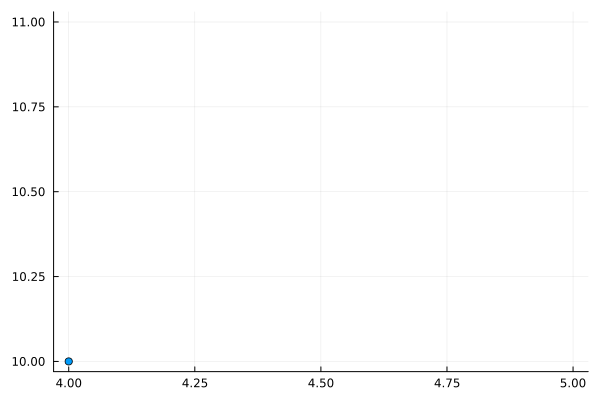

Test Summary: | Pass  Total  Time
Param & Model |    8      8  3.4s


In [4]:
@enum Strategy C D

@with_kw mutable struct Param
    N::Int = 100               # population
    k₀::Int = 2                # initial degree
    C_rate₀::Float64 = 0.5     # initial cooperator(C)'s freqtrialscy
    b::Float64 = 1.25          # benefit to defect
    resource_decrement_factor::Float64 = 0.9
    resource_limit::Float64 = 0.5
    ev_hop::Int = -1           # rich spot の移動幅 (場所)
    ev_interval::Int = 1       # rich spot の移動間隔 (時間)
    δ::Float64 = 0.99          # selection pressure
    μ::Float64 = 0.01          # mutation rate
    generations::Int = 2_000   # time steps
    trials::Int = 10           # trial count
    rng::MersenneTwister = MersenneTwister() # random generator
end

mutable struct Model
    # model's parameters
    p::Param
    rich_spot::Int # spot which has richest resource

    # agent's parameters
    strategy_vec::Vector{Strategy}  # agents' strategy
    resource_vec::Vector{Float64}   # agents' resource
    g::SimpleGraph

    function Model(p::Param)
        C_count = round(Int, p.N * p.C_rate₀)
        strategy_vec = shuffle(p.rng, vcat(fill(C, C_count), fill(D, p.N - C_count)))

        resource_vec = fill(0.0, p.N)

        g = create_cycle_graph(p.N, p.k₀)

        return new(p, 1, strategy_vec, resource_vec, g)
    end
end

C_rate(m::Model)::Float64 = mean([s == C for s in m.strategy_vec])

average_resource(m::Model)::Float64 = mean(m.resource_vec)

strategy_to_color_vec(m::Model)::Vector{RGB} = [s == C ? DARK_BLUE : DARK_RED for s in m.strategy_vec]

degree_distribution(g::SimpleGraph)::Dict{Int, Int} = countmap(degree(g))

function plot_graph(m::Model)::Nothing
    n = nv(m.g)
    θ = 2 * π / n  # 各ノードの間の角度
    x_coords = [cos(i * θ - π/2) for i in 0:n-1]
    y_coords = [sin(i * θ - π/2) for i in 0:n-1]

    # layout関数を定義してノードの座標を渡す
    layout = (g -> (x_coords, y_coords))

    gplot(m.g, nodelabel=1:m.p.N, layout=layout, nodelabelc=GRAY, nodefillc=strategy_to_color_vec(m)) |> display

    return
end

function plot_degree_distribution(g::SimpleGraph)::Nothing
    degree_count = sort(degree_distribution(g))
    xs = collect(keys(degree_count))
    ys = [degree_count[x] for x in xs]
    plot(xs, ys, seriestype=:scatter, legend=false) |> display
end

@testset "Param & Model" begin
    m = Model(Param())
    @test m.p.N == nv(m.g) == length(m.strategy_vec) == length(m.resource_vec) == 100
    @test C_rate(m) == 0.5
    @test m.resource_vec == fill(0.0, m.p.N)
    @test mean(degree(m.g)) == 2.0

    m = Model(Param(N = 10, k₀ = 4, C_rate₀ = 0.2))
    @test m.p.N == nv(m.g) == length(m.strategy_vec) == length(m.resource_vec) == 10
    @test C_rate(m) == 0.2
    @test m.resource_vec == fill(0.0, m.p.N)
    @test mean(degree(m.g)) == 4.0

    plot_graph(Model(Param(N = 20, k₀ = 10, C_rate₀ = 0.4)))
    plot_degree_distribution(m.g)
end;

## Resource allocation

In [5]:
function resource_allocation!(m::Model)::Nothing
    if m.p.ev_hop < 0
        m.rich_spot = rand(m.p.rng, 1:m.p.N)
    elseif m.p.ev_hop == 0
        # rich_spot is not moved
    else
        m.rich_spot = mod(m.rich_spot + rand(m.p.rng, -m.p.ev_hop:m.p.ev_hop) - 1, m.p.N) + 1
    end
    
    distance_vec = [abs(i - m.rich_spot) for i in 1:m.p.N]
    distance_vec = [distance > m.p.N ÷ 2 ? m.p.N - distance : distance for distance in distance_vec]
    m.resource_vec = [m.p.resource_decrement_factor^distance for distance in distance_vec]

    return
end

@testset "resource_allocation!" begin
    @testset "ev_hop = -1" begin
        m = Model(Param(N = 10, k₀ = 4, resource_decrement_factor = 0.5, rng = MersenneTwister(1)))
        resource_allocation!(m)
        @test m.rich_spot == 6
        @test m.resource_vec == [1/2^5, 1/2^4, 1/2^3, 1/2^2, 1/2, 1, 1/2, 1/2^2, 1/2^3, 1/2^4]

        m = Model(Param(N = 10, k₀ = 4, resource_decrement_factor = 0.5, rng = MersenneTwister(2)))
        resource_allocation!(m)
        @test m.rich_spot == 1
        @test m.resource_vec == [1, 1/2, 1/2^2, 1/2^3, 1/2^4, 1/2^5, 1/2^4, 1/2^3, 1/2^2, 1/2]
    end

    @testset "ev_hop = 1" begin
        m = Model(Param(N = 10, k₀ = 4, ev_hop  = 1, resource_decrement_factor = 0.5, rng = MersenneTwister(1)))
        prior_position = m.rich_spot
        hop_vec = []
        for _ in 1:100
            resource_allocation!(m)
            hop = prior_position - m.rich_spot
            hop = hop > 1 ? -1 : hop
            hop = hop < -1 ? 1 : hop
            append!(hop_vec, hop)
            prior_position = m.rich_spot
        end
        @test mean(hop_vec) ≈ 0.0 atol = 0.1
        @test std(hop_vec) ≈ 0.84 atol = 0.1
    end
end;

Test Summary:        | Pass  Total  Time
resource_allocation! |    6      6  0.0s


## Interaction

In [6]:
function interaction!(m::Model)::Vector{Tuple{Int, Int}}
    id_pair_vec = [(focal_id, rand(m.p.rng, neighbors(m.g, focal_id))) for focal_id in 1:m.p.N if length(neighbors(m.g, focal_id)) > 0]

    for (focal_id, opponent_id) in id_pair_vec
        strategy_pair = m.strategy_vec[[focal_id, opponent_id]]
        focal_resource, opponent_resource = [max(r - m.p.resource_limit, 0) for r in m.resource_vec[[focal_id, opponent_id]]]

        if strategy_pair == [C, C]
            poor_resource = (focal_resource + opponent_resource) * m.p.b
            m.resource_vec[focal_id] += poor_resource / 2 - focal_resource
            m.resource_vec[opponent_id] += poor_resource / 2 - opponent_resource
        elseif strategy_pair == [C, D]
            poor_resource = focal_resource * m.p.b
            m.resource_vec[focal_id] += poor_resource / 2 - focal_resource
            m.resource_vec[opponent_id] += poor_resource / 2
        elseif strategy_pair == [D, C]
            poor_resource = opponent_resource * m.p.b
            m.resource_vec[focal_id] += poor_resource / 2
            m.resource_vec[opponent_id] += poor_resource / 2 - opponent_resource
        else
            # if rand() > 0.9
            #     rem_edge!(m.g, focal_id, opponent_id)
            #     # add_edge!(m.g, sample(1:m.p.N, 2, replace = false)...)
            # end
        end
    end

    return id_pair_vec
end

@testset "interaction!" begin
    @testset "normal" begin
        m = Model(Param(N = 10, k₀ = 4, C_rate₀ = 0.4, resource_decrement_factor = 0.5, resource_limit = 0.1, rng = MersenneTwister(1)))
        resource_allocation!(m)
        @test m.strategy_vec == [D, D, C, D, C, D, D, C, D, C]
        @test m.resource_vec == [0.03125, 0.0625, 0.125, 0.25, 0.5, 1.0, 0.5, 0.25, 0.125, 0.0625]

        pair_id_vec = interaction!(m)
        @test pair_id_vec == [(1, 3), (2, 10), (3, 5), (4, 6), (5, 7), (6, 5), (7, 9), (8, 10), (9, 1), (10, 1)]
        @test m.resource_vec == [0.08203125, 0.0625, 0.359765625, 0.25, 0.20147094726562498, 1.101470947265625, 0.662353515625, 0.19375, 0.125, 0.13515625]

        m = Model(Param(N = 10, k₀ = 4, C_rate₀ = 0.4, resource_decrement_factor = 0.5, resource_limit = 0.0, rng = MersenneTwister(1)))
        resource_allocation!(m)
        @test m.strategy_vec == [D, D, C, D, C, D, D, C, D, C]
        @test m.resource_vec == [0.03125, 0.0625, 0.125, 0.25, 0.5, 1.0, 0.5, 0.25, 0.125, 0.0625]

        id_pair_vec = interaction!(m)
        @test id_pair_vec == [(1, 3), (2, 10), (3, 5), (4, 6), (5, 7), (6, 5), (7, 9), (8, 10), (9, 1), (10, 1)]
        @test m.resource_vec == [0.2222900390625, 0.1015625, 0.361328125, 0.25, 0.141143798828125, 1.141143798828125, 0.725830078125, 0.1806640625, 0.125, 0.1129150390625]
    end
    
    @testset "solitary node" begin
        m = Model(Param(N = 10, k₀ = 4, C_rate₀ = 0.4, resource_decrement_factor = 0.5, resource_limit = 0.1, rng = MersenneTwister(1)))
        resource_allocation!(m)
        @test m.strategy_vec == [D, D, C, D, C, D, D, C, D, C]
        @test m.resource_vec == [0.03125, 0.0625, 0.125, 0.25, 0.5, 1.0, 0.5, 0.25, 0.125, 0.0625]

        # delete all edges of 3
        rem_edge!(m.g, 3, 1)
        rem_edge!(m.g, 3, 2)
        rem_edge!(m.g, 3, 4)
        rem_edge!(m.g, 3, 5)
        # delete all edges of 6 except (6, 5)
        rem_edge!(m.g, 6, 4)
        rem_edge!(m.g, 6, 7)
        rem_edge!(m.g, 6, 8)
        # delete all edges of 10
        rem_edge!(m.g, 10, 1)
        rem_edge!(m.g, 10, 2)
        rem_edge!(m.g, 10, 8)
        rem_edge!(m.g, 10, 9)

        id_pair_vec = interaction!(m)
        @test id_pair_vec == [(1, 2), (2, 4), (4, 5), (5, 7), (6, 5), (7, 5), (8, 9), (9, 8)]
        @test m.resource_vec == [0.03125, 0.0625, 0.125, 0.5, 0.16103515624999998, 1.09765625, 0.71728515625, 0.15859375, 0.27734375, 0.0625]
    end
end;

Test Summary: | Pass  Total  Time
interaction!  |   12     12  0.1s


## Death & Birth

In [7]:
mutate(strategy::Strategy)::Strategy = (strategy == C ? D : C)

function regularize_resource_vec(resource_vec::Vector{Float64}, positive::Bool)::Weights
    weights = positive ? resource_vec .- minimum(resource_vec) : maximum(resource_vec) .- resource_vec
    weights .+= 0.0001
    weights = weights ./ maximum(weights)

    return Weights(weights)
end

function death_birth!(m::Model)::Tuple{Int, Int, Vector{Int}}
    death_weights = regularize_resource_vec(m.resource_vec, false)
    parent_weights = regularize_resource_vec(m.resource_vec, true)

    death_id = sample(m.p.rng, 1:m.p.N, death_weights)
    strategy_parent_id = sample(m.p.rng, 1:m.p.N, parent_weights)

    # Strategy
    parent_strategy = m.strategy_vec[strategy_parent_id]
    m.strategy_vec[death_id] = rand(m.p.rng) > m.p.μ ? parent_strategy : mutate(parent_strategy)

    # Graph
    graph_parent_id_vec = []
    neighbor_vec = copy(neighbors(m.g, death_id))
    if length(neighbor_vec) > 0
        ## Delete edges
        for n in neighbor_vec
            rem_edge!(m.g, death_id, n)
        end

        ## Add edges
        graph_parent_id_vec = sort(sample(m.p.rng, 1:m.p.N, parent_weights, length(neighbor_vec), replace = false))
        # graph_parent_id_vec = sort(sample(m.p.rng, 1:m.p.N, parent_weights, m.p.k₀, replace = false))
        for graph_parent_id in graph_parent_id_vec
            add_edge!(m.g, death_id, graph_parent_id)
        end
    end

    return death_id, strategy_parent_id, graph_parent_id_vec
end

@testset "regularize_resource_vec" begin
    @test regularize_resource_vec([0.0, 0.0, 0.0, 0.0, 0.0], true) == [1.0, 1.0, 1.0, 1.0, 1.0]
    @test regularize_resource_vec([1.0, 1.0, 1.0, 1.0, 1.0], true) == [1.0, 1.0, 1.0, 1.0, 1.0]

    @test regularize_resource_vec([0.0, 0.0, 1.0, 0.0, 0.0], true) ≈ [0.0, 0.0, 1.0, 0.0, 0.0] atol = 0.001
    @test regularize_resource_vec([0.0, 0.0, 1.0, 0.0, 0.0], false) ≈ [1.0, 1.0, 0.0, 1.0, 1.0] atol = 0.001
    @test regularize_resource_vec([0.0, 0.0, -1.0, 0.0, 0.0], true) ≈ [1.0, 1.0, 0.0, 1.0, 1.0] atol = 0.001

    @test regularize_resource_vec([0.0, 0.2, 0.4, 0.6, 0.8], true) ≈ [0.0, 0.25, 0.5, 0.75, 1.0] atol = 0.001
    @test regularize_resource_vec([0.0, 0.2, 0.4, 0.6, 0.8], false) ≈ [1.0, 0.75, 0.5, 0.25, 0.0] atol = 0.001
    @test regularize_resource_vec([0.0, -0.2, -0.4, -0.6, -0.8], true) ≈ [1.0, 0.75, 0.5, 0.25, 0.0] atol = 0.001
end

@testset "death_birth!" begin
    m = Model(Param(N = 10, k₀ = 4, C_rate₀ = 0.4, rng = MersenneTwister(1)))
    resource_allocation!(m)
    @test m.rich_spot == 6
    @test degree(m.g) == fill(4, 10)
    @test m.strategy_vec == [D, D, C, D, C, D, D, C, D, C]

    death_id, strategy_parent_id, graph_parent_id_vec = death_birth!(m)
    @test death_id == 3
    @test strategy_parent_id == 7
    @test m.strategy_vec == [D, D, D, D, C, D, D, C, D, C]
    @test graph_parent_id_vec == [2, 3, 6, 8]
    @test degree(m.g) == [3, 4, 4, 3, 3, 5, 4, 5, 4, 4]
    @test ne(m.g) == 20
end;

Test Summary:           | Pass  Total  Time
regularize_resource_vec |    8      8  0.1s
Test Summary: | Pass  Total  Time
death_birth!  |    9      9  0.2s


## Run all

In [8]:
function run!(m::Model)::Tuple{Vector{Float64}, Vector{Float64}}
    C_rate_vec = fill(0.0, m.p.generations)
    average_resource_vec = fill(0.0, m.p.generations)

    for generation in 1:m.p.generations
        if generation % m.p.ev_interval == 0
            resource_allocation!(m)
        end

        interaction!(m)
        death_birth!(m)
        
        C_rate_vec[generation] = C_rate(m)
        average_resource_vec[generation] = average_resource(m)
    end

    return C_rate_vec, average_resource_vec
end;

# Results

## ToDo

- 選択強度
- 環境変動のインターバル
- 協力者同士が繋がりやすくする
- 複数試行結果を表示
- 死亡誕生過程の人数を増やす

In [9]:
ev_hop_vec = [0, 1, 3, 9, 27, 81, -1]
resource_decrement_factor_vec = [0.3, 0.5, 0.7, 0.9, 1.0]

@show params = vec([(ev_hop, rdf) for ev_hop in ev_hop_vec, rdf in resource_decrement_factor_vec]);

params = vec([(ev_hop, rdf) for ev_hop = ev_hop_vec, rdf = resource_decrement_factor_vec]) = [(0, 0.3), (1, 0.3), (3, 0.3), (9, 0.3), (27, 0.3), (81, 0.3), (-1, 0.3), (0, 0.5), (1, 0.5), (3, 0.5), (9, 0.5), (27, 0.5), (81, 0.5), (-1, 0.5), (0, 0.7), (1, 0.7), (3, 0.7), (9, 0.7), (27, 0.7), (81, 0.7), (-1, 0.7), (0, 0.9), (1, 0.9), (3, 0.9), (9, 0.9), (27, 0.9), (81, 0.9), (-1, 0.9), (0, 1.0), (1, 1.0), (3, 1.0), (9, 1.0), (27, 1.0), (81, 1.0), (-1, 1.0)]


ev_hop: 0, resource_decrement_factor: 0.3
C_rate: 0.006651674162918518
average_resource: 0.018571428571428655
Average Degree (k̄):	 4.0
Average Distance (L):	 2.1758462421113025
Average Clustering Coefficient (C):	 0.18080568720379148


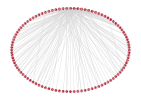

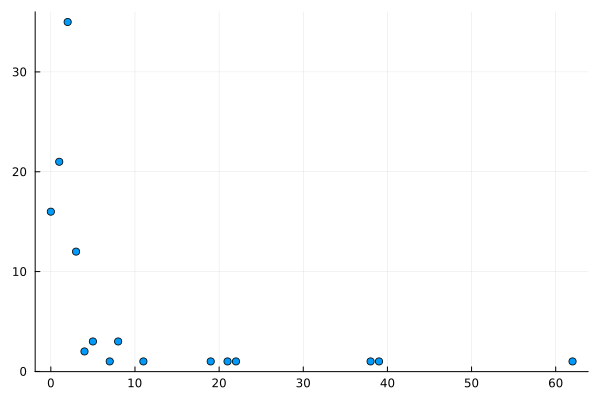

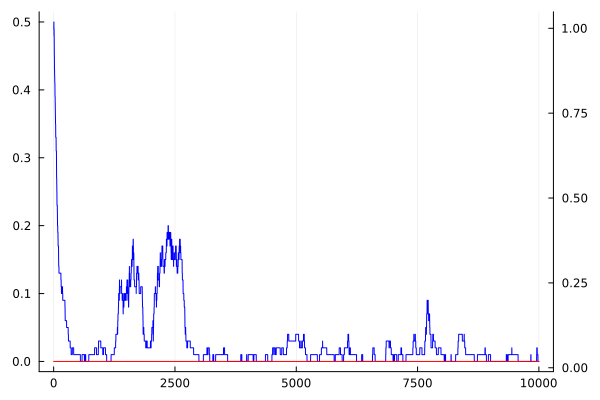

ev_hop: 1, resource_decrement_factor: 0.3
C_rate: 0.004227886056971516
average_resource: 0.018571428571428655
Average Degree (k̄):	 4.0
Average Distance (L):	 2.5572010366530913
Average Clustering Coefficient (C):	 0.2866638969671791


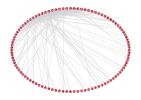

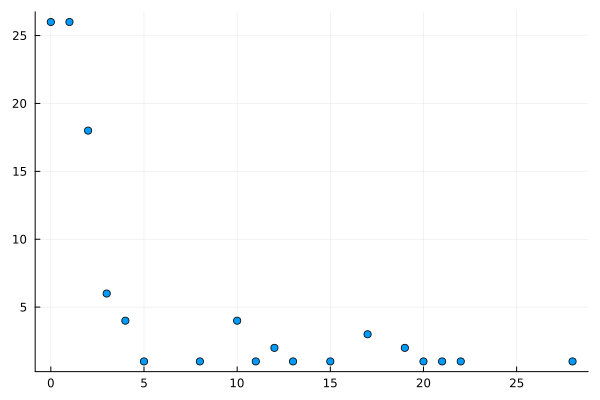

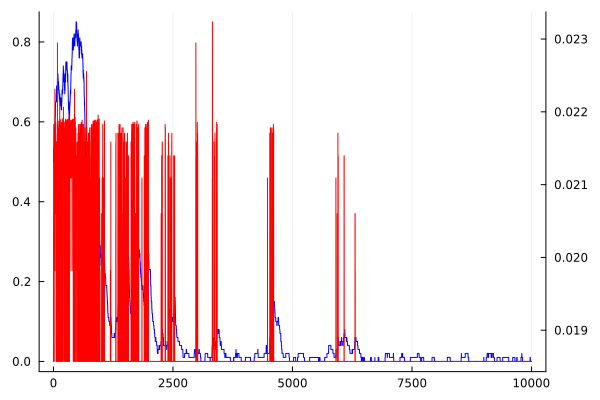

ev_hop: 3, resource_decrement_factor: 0.3
C_rate: 0.019125437281359313
average_resource: 0.01860279868959221
Average Degree (k̄):	 4.0
Average Distance (L):	 2.997543859649123
Average Clustering Coefficient (C):	 0.2102461743180306


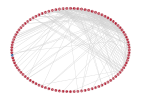

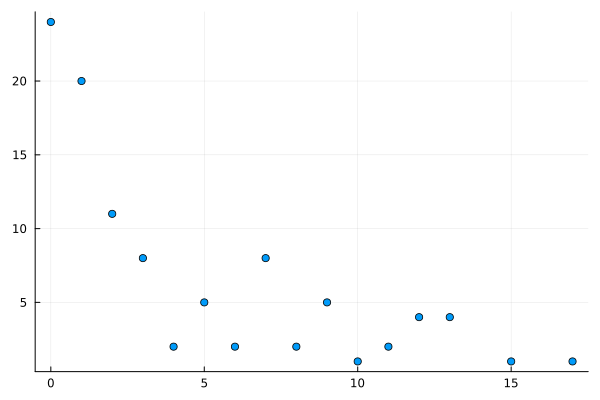

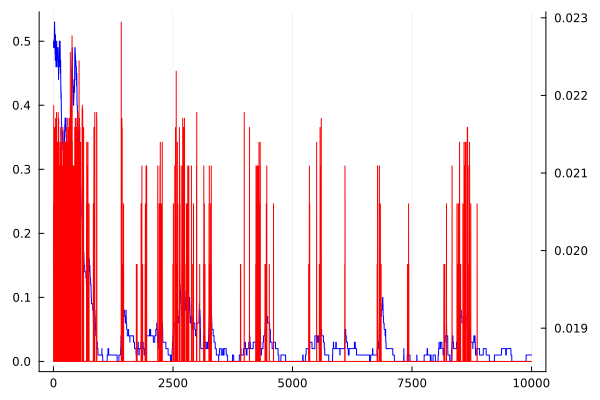

ev_hop: 9, resource_decrement_factor: 0.3
C_rate: 0.1490604697651174
average_resource: 0.018846900101928996
Average Degree (k̄):	 4.0
Average Distance (L):	 3.631390348781653
Average Clustering Coefficient (C):	 0.08886810102899906


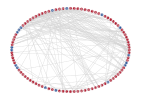

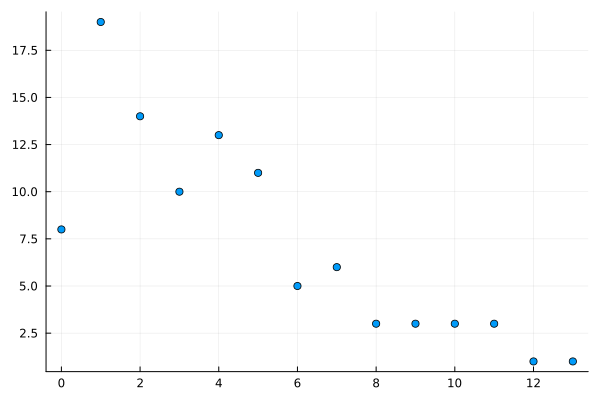

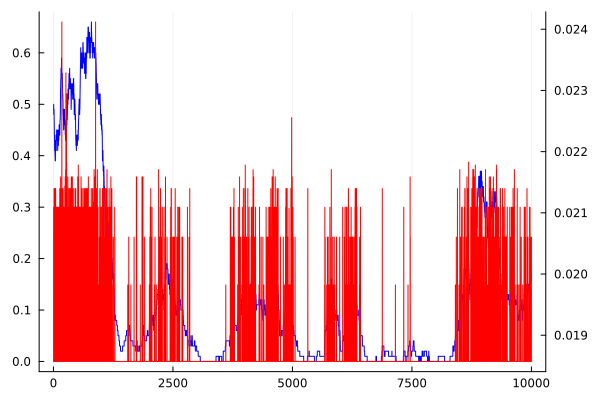

ev_hop: 27, resource_decrement_factor: 0.3
C_rate: 0.015882058970514708
average_resource: 0.018598957474366087
Average Degree (k̄):	 4.0
Average Distance (L):	 3.647590995160951
Average Clustering Coefficient (C):	 0.0160857908847185


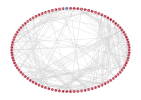

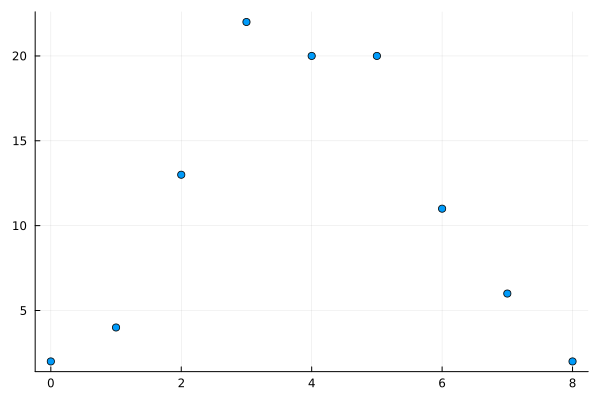

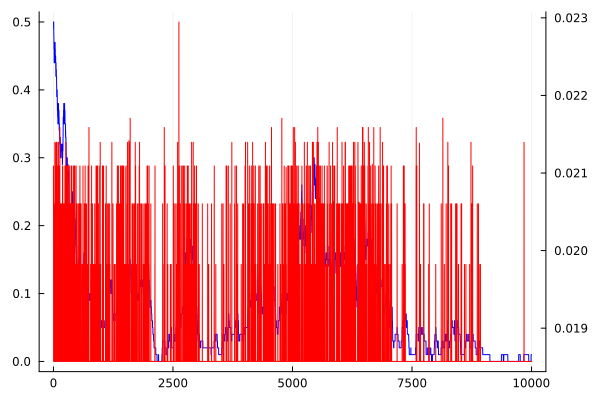

ev_hop: 81, resource_decrement_factor: 0.3
C_rate: 0.01827586206896547
average_resource: 0.01861349616068089
Average Degree (k̄):	 4.0
Average Distance (L):	 3.85446299732014
Average Clustering Coefficient (C):	 0.05912596401028278


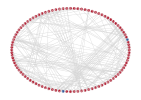

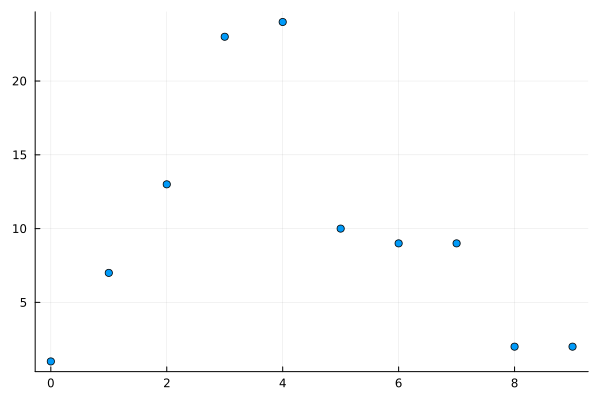

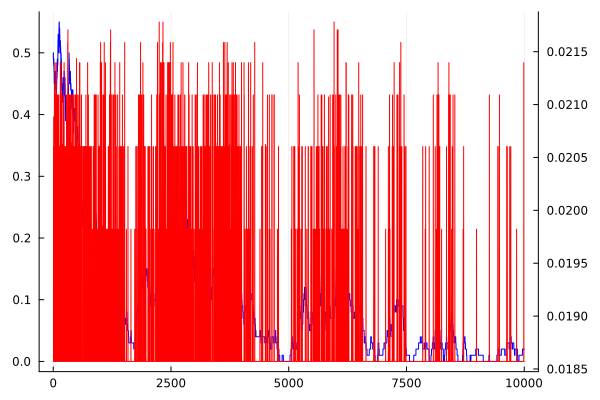

ev_hop: -1, resource_decrement_factor: 0.3
C_rate: 0.14190904547726133
average_resource: 0.018840912817360715
Average Degree (k̄):	 4.0
Average Distance (L):	 3.8376288659793816
Average Clustering Coefficient (C):	 0.12101063829787234


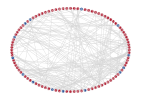

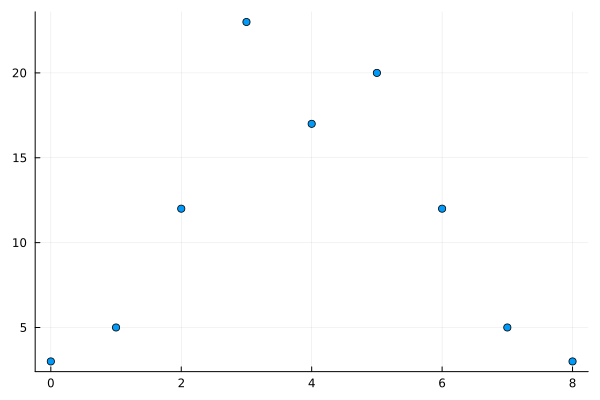

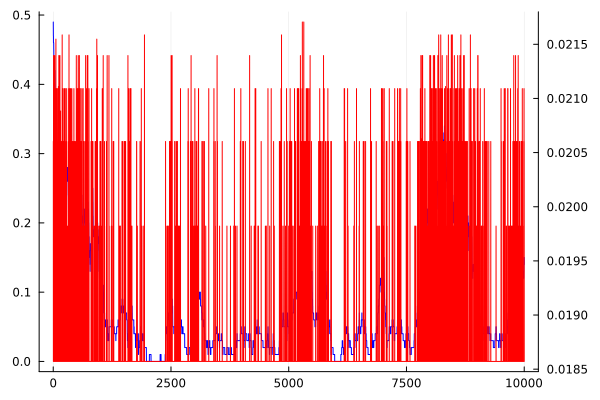

ev_hop: 0, resource_decrement_factor: 0.5
C_rate: 0.9845677161419293
average_resource: 0.03324473003194889
Average Degree (k̄):	 4.0
Average Distance (L):	 2.1151020408163266
Average Clustering Coefficient (C):	 0.43837910247823175


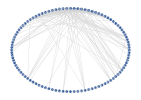

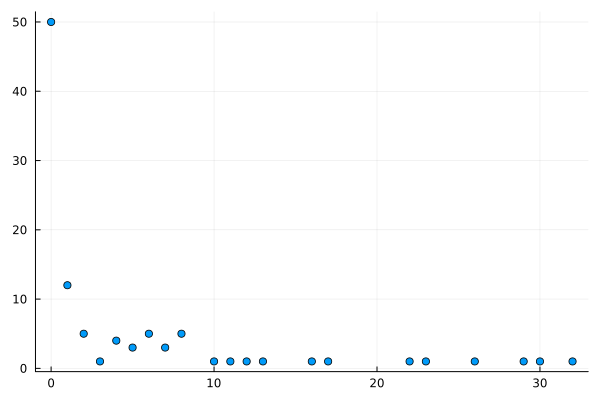

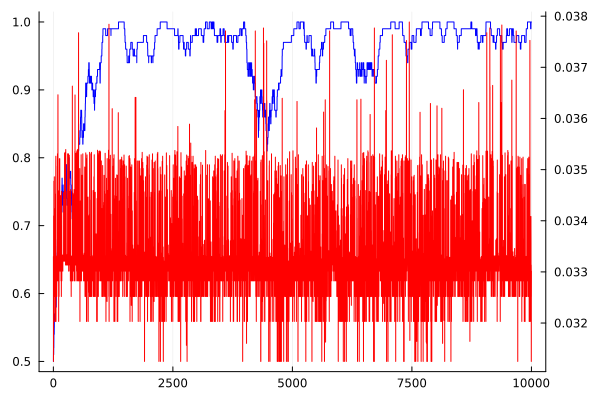

ev_hop: 1, resource_decrement_factor: 0.5
C_rate: 0.43177411294352835
average_resource: 0.03105017208375374
Average Degree (k̄):	 4.0
Average Distance (L):	 2.3542976939203353
Average Clustering Coefficient (C):	 0.4230614704700683


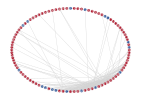

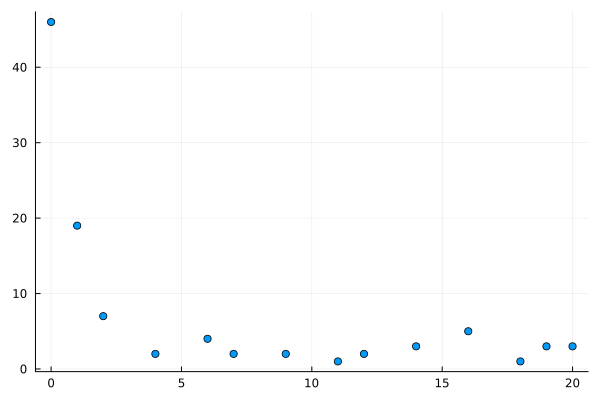

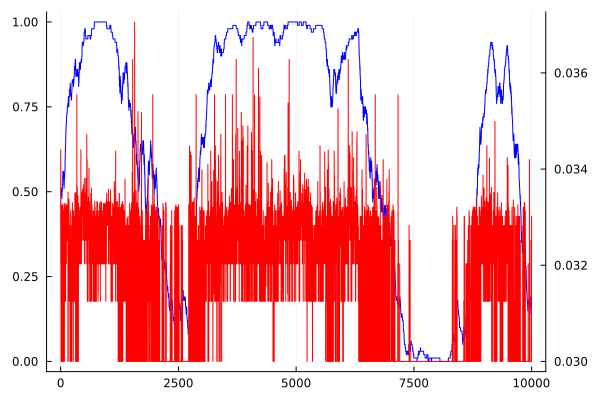

ev_hop: 3, resource_decrement_factor: 0.5
C_rate: 0.042453773113443186
average_resource: 0.030139580592699326
Average Degree (k̄):	 4.0
Average Distance (L):	 2.8776641091219095
Average Clustering Coefficient (C):	 0.26905829596412556


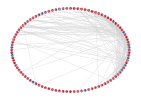

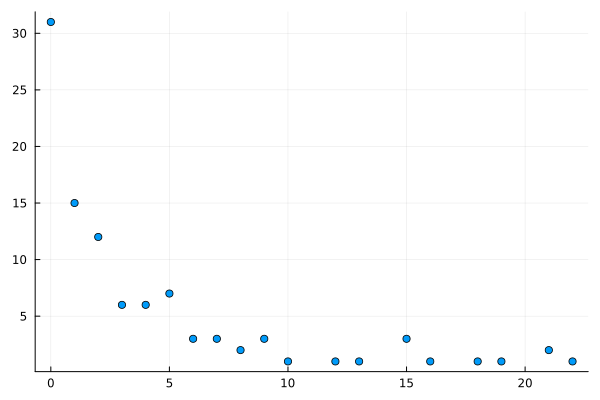

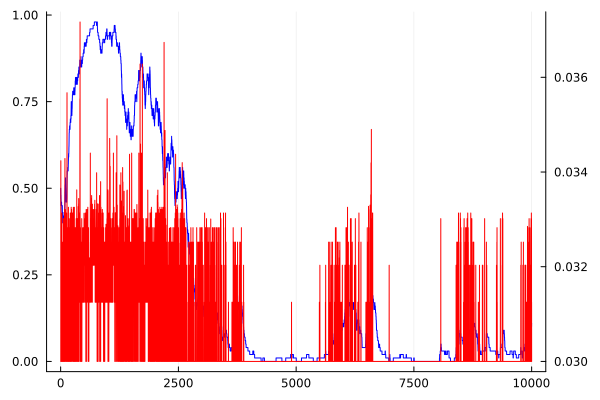

ev_hop: 9, resource_decrement_factor: 0.5
C_rate: 0.15110944527736142
average_resource: 0.030303793981194805
Average Degree (k̄):	 4.0
Average Distance (L):	 3.300989040363539
Average Clustering Coefficient (C):	 0.11478260869565217


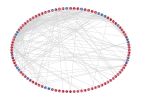

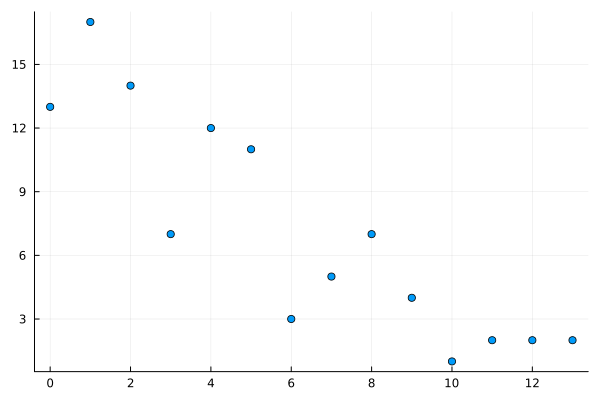

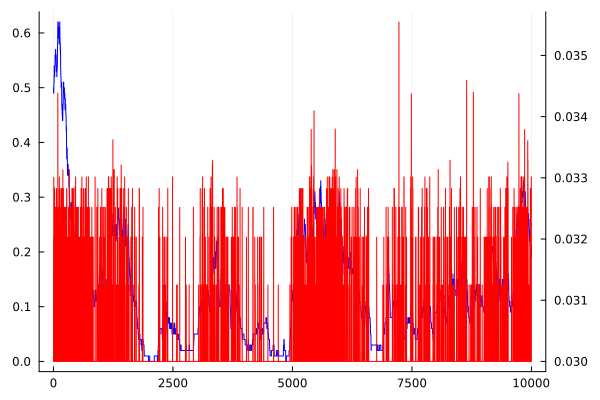

ev_hop: 27, resource_decrement_factor: 0.5
C_rate: 0.03525737131434278
average_resource: 0.030054546701258813
Average Degree (k̄):	 4.0
Average Distance (L):	 3.7641752577319587
Average Clustering Coefficient (C):	 0.048628428927680795


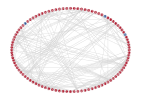

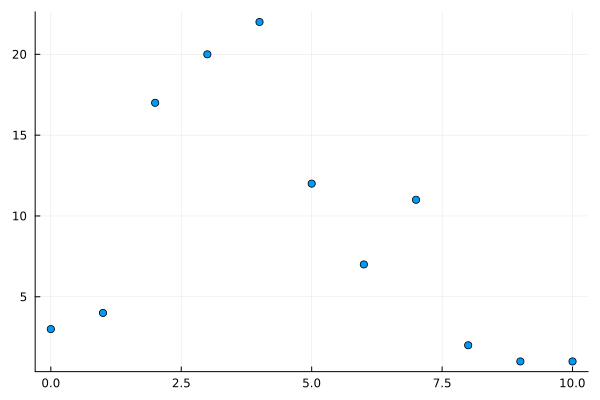

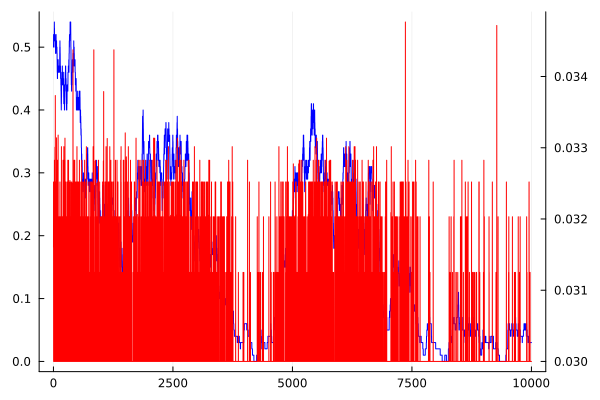

ev_hop: 81, resource_decrement_factor: 0.5
C_rate: 0.027761119440279796
average_resource: 0.030052555016074945
Average Degree (k̄):	 4.0
Average Distance (L):	 3.584192439862543
Average Clustering Coefficient (C):	 0.04408352668213457


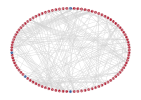

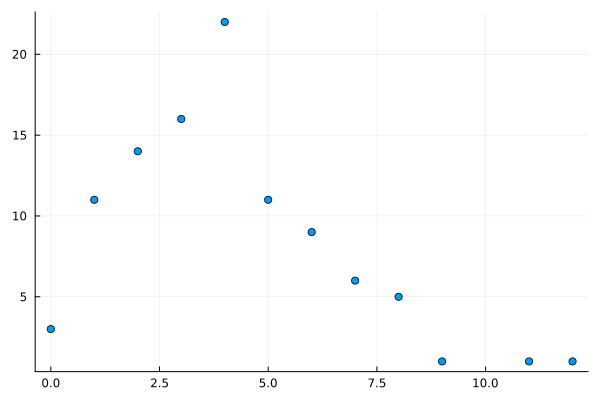

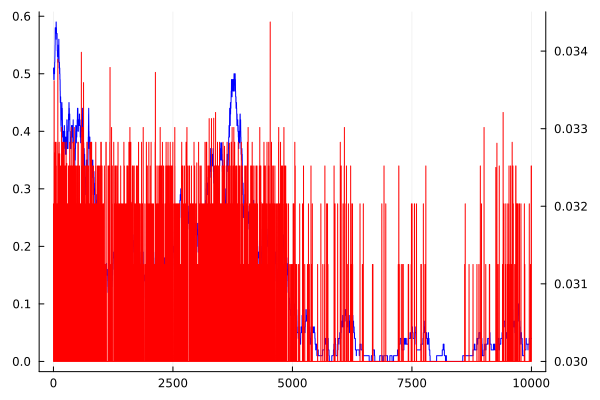

ev_hop: -1, resource_decrement_factor: 0.5
C_rate: 0.11485257371314347
average_resource: 0.030212060260162505
Average Degree (k̄):	 4.0
Average Distance (L):	 3.5442878182200714
Average Clustering Coefficient (C):	 0.03551912568306011


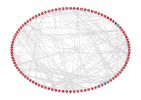

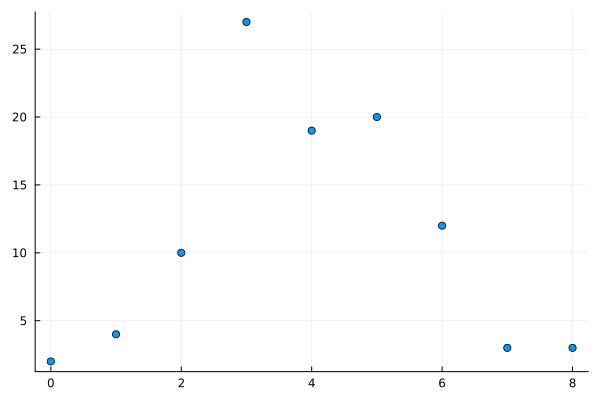

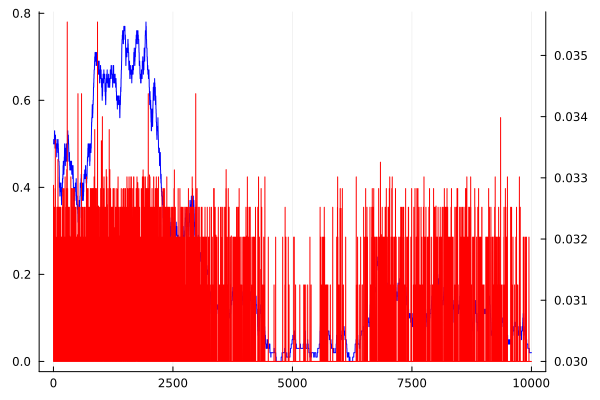

ev_hop: 0, resource_decrement_factor: 0.7
C_rate: 0.017916041979010474
average_resource: 0.05669378997250923
Average Degree (k̄):	 4.0
Average Distance (L):	 1.9817073170731707
Average Clustering Coefficient (C):	 0.6082677165354331


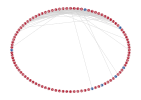

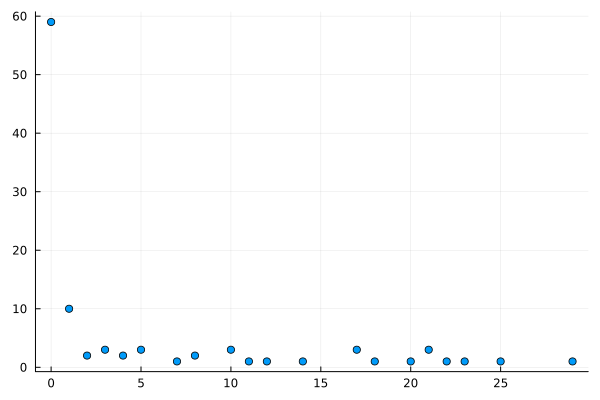

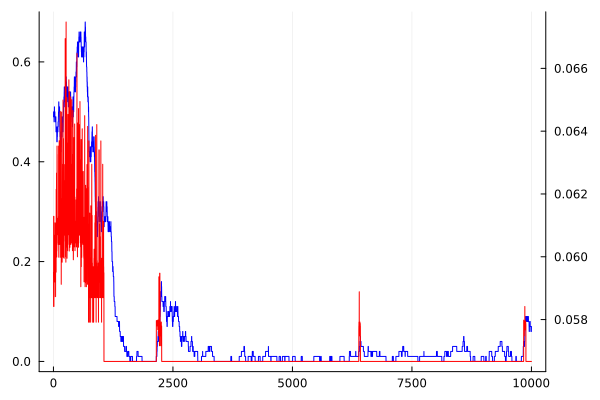

ev_hop: 1, resource_decrement_factor: 0.7
C_rate: 0.05328835582208907
average_resource: 0.05683923296495211
Average Degree (k̄):	 4.0
Average Distance (L):	 2.436651583710407
Average Clustering Coefficient (C):	 0.2540816326530612


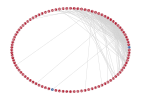

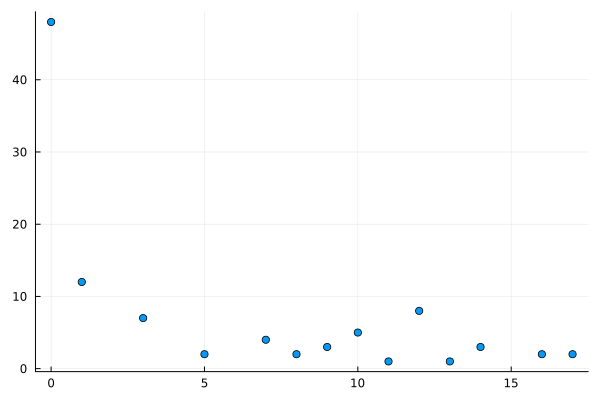

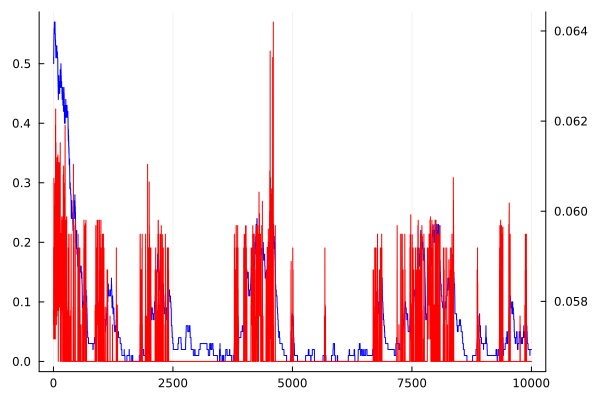

ev_hop: 3, resource_decrement_factor: 0.7
C_rate: 0.03413793103448268
average_resource: 0.056756505388863565
Average Degree (k̄):	 4.0
Average Distance (L):	 2.485588972431078
Average Clustering Coefficient (C):	 0.24881141045958796


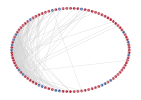

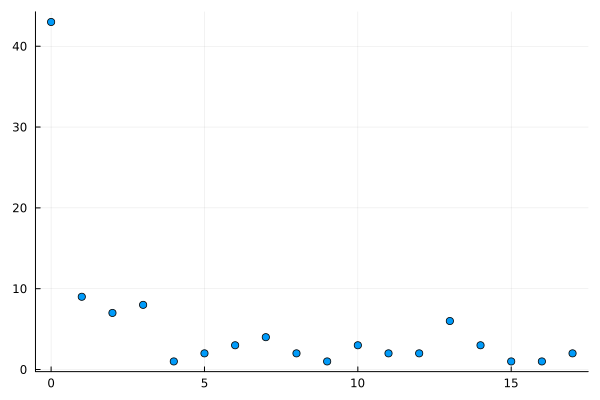

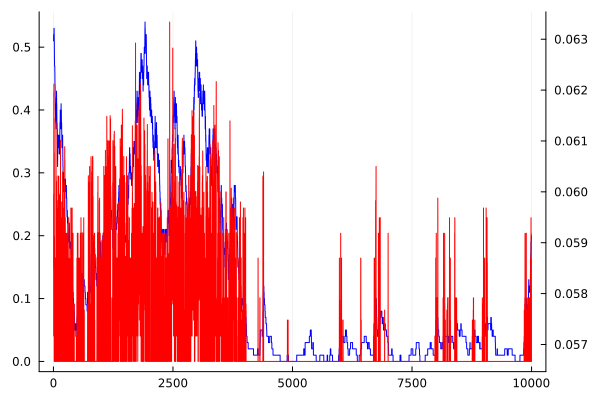

ev_hop: 9, resource_decrement_factor: 0.7
C_rate: 0.09285857071464271
average_resource: 0.05701057752163154
Average Degree (k̄):	 4.0
Average Distance (L):	 3.5568519789521846
Average Clustering Coefficient (C):	 0.1282798833819242


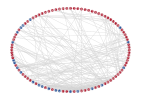

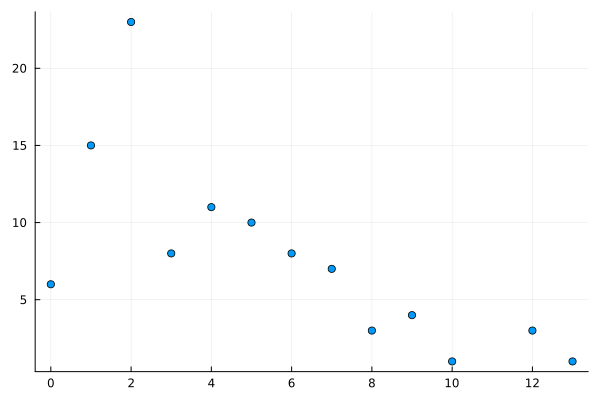

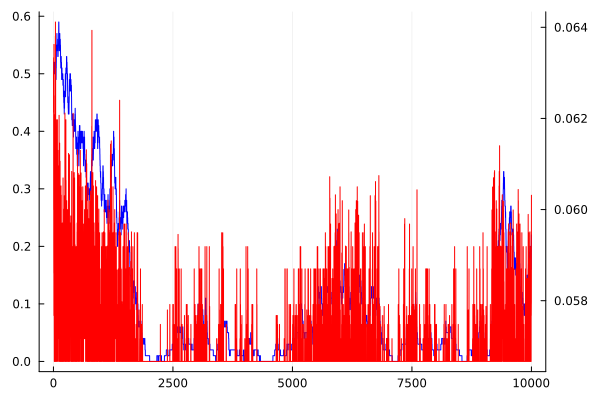

ev_hop: 27, resource_decrement_factor: 0.7
C_rate: 0.4933033483258373
average_resource: 0.05833183785900011
Average Degree (k̄):	 4.0
Average Distance (L):	 3.547103689960833
Average Clustering Coefficient (C):	 0.04398447606727038


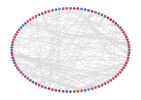

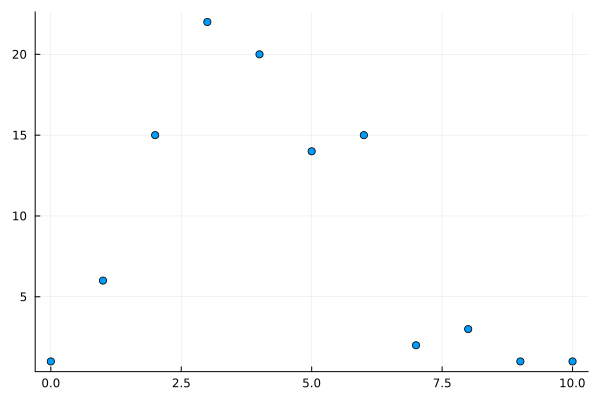

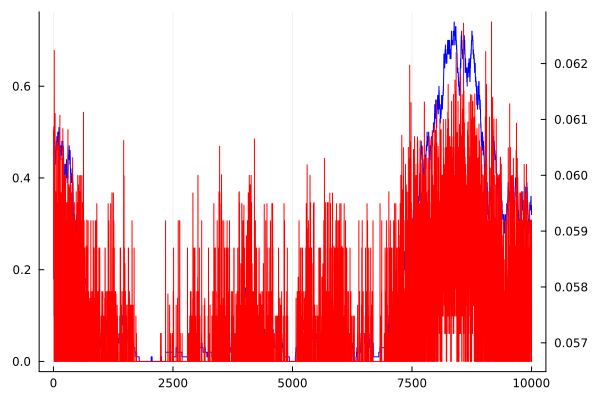

ev_hop: 81, resource_decrement_factor: 0.7
C_rate: 0.5741229385307343
average_resource: 0.05860053923926242
Average Degree (k̄):	 4.0
Average Distance (L):	 3.647380601725226
Average Clustering Coefficient (C):	 0.051587301587301584


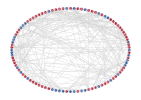

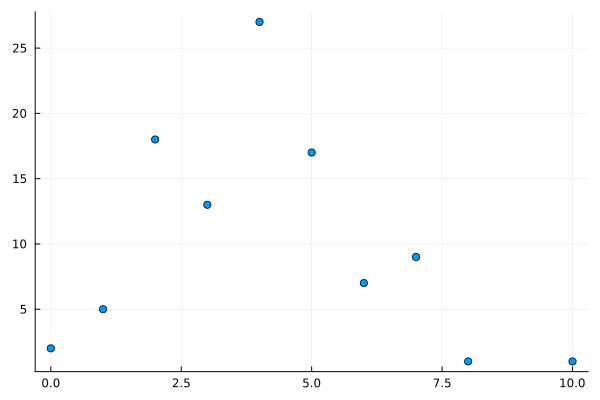

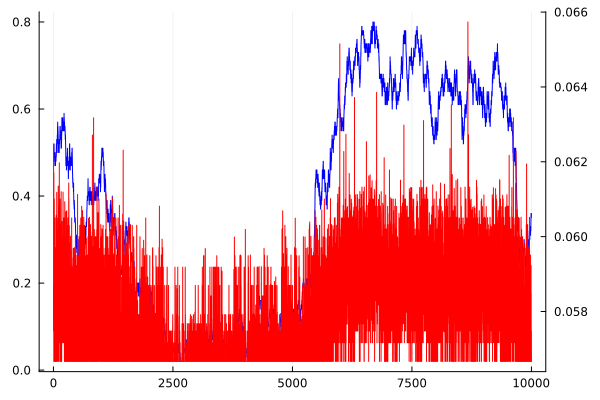

ev_hop: -1, resource_decrement_factor: 0.7
C_rate: 0.041799100449775035
average_resource: 0.05681069972943362
Average Degree (k̄):	 4.0
Average Distance (L):	 3.5985693246370714
Average Clustering Coefficient (C):	 0.04918032786885246


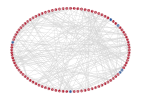

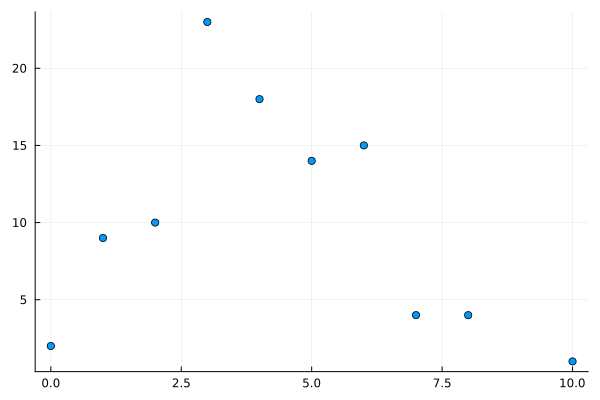

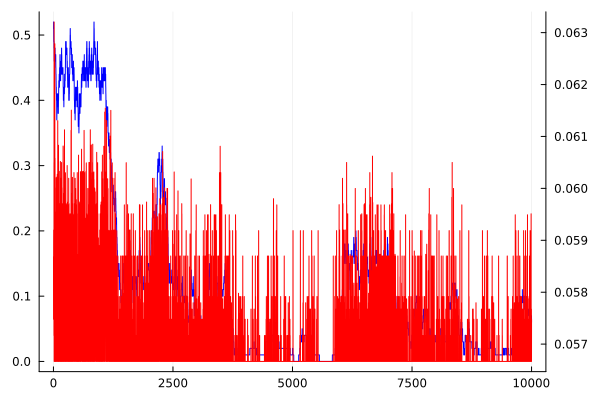

ev_hop: 0, resource_decrement_factor: 0.9
C_rate: 0.006396801599200398
average_resource: 0.18902078271060865
Average Degree (k̄):	 4.0
Average Distance (L):	 2.599702380952381
Average Clustering Coefficient (C):	 0.2912565141864505


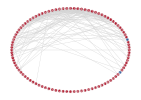

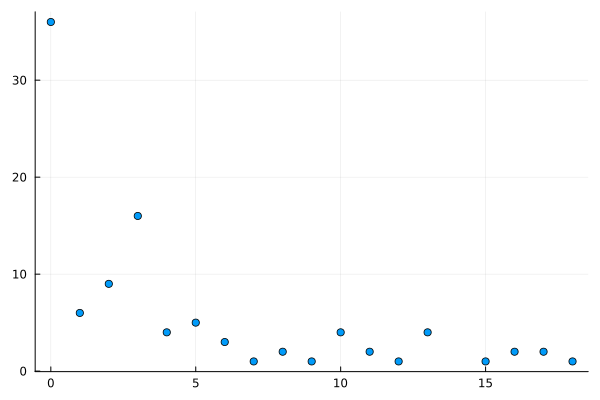

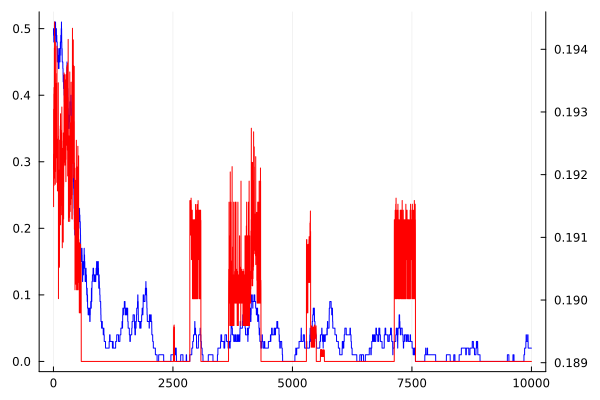

ev_hop: 1, resource_decrement_factor: 0.9
C_rate: 0.009290354822588701
average_resource: 0.1891485218010978
Average Degree (k̄):	 4.0
Average Distance (L):	 2.842162162162162
Average Clustering Coefficient (C):	 0.18541666666666667


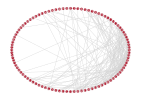

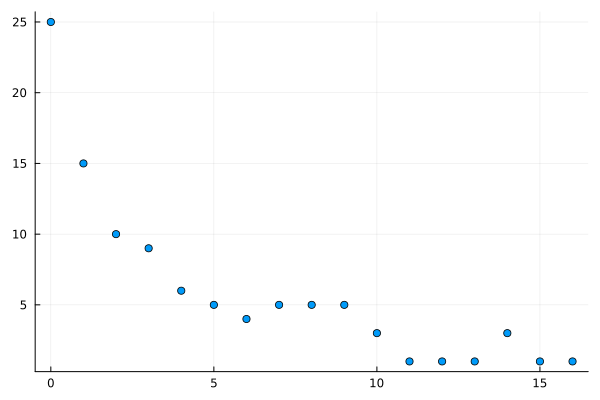

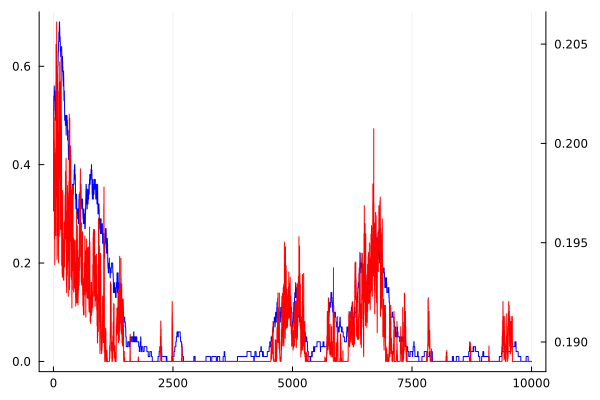

ev_hop: 3, resource_decrement_factor: 0.9
C_rate: 0.06857071464267869
average_resource: 0.18978000163574962
Average Degree (k̄):	 4.0
Average Distance (L):	 2.9044303797468354
Average Clustering Coefficient (C):	 0.1059322033898305


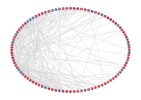

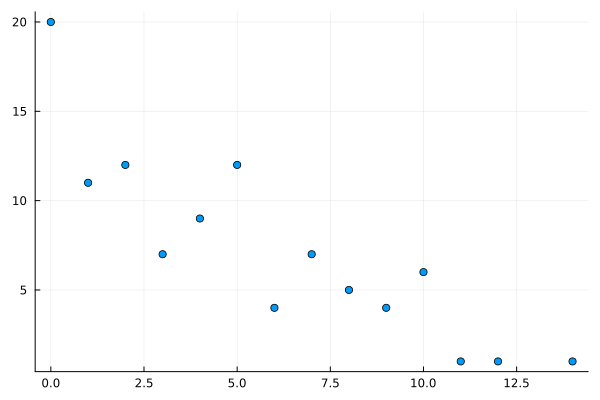

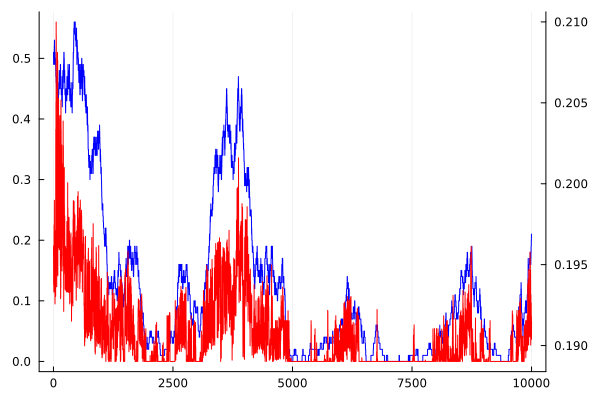

ev_hop: 9, resource_decrement_factor: 0.9
C_rate: 0.0199150424787606
average_resource: 0.18924376314822583
Average Degree (k̄):	 4.0
Average Distance (L):	 3.2788766788766788
Average Clustering Coefficient (C):	 0.03875968992248062


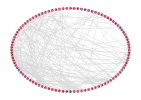

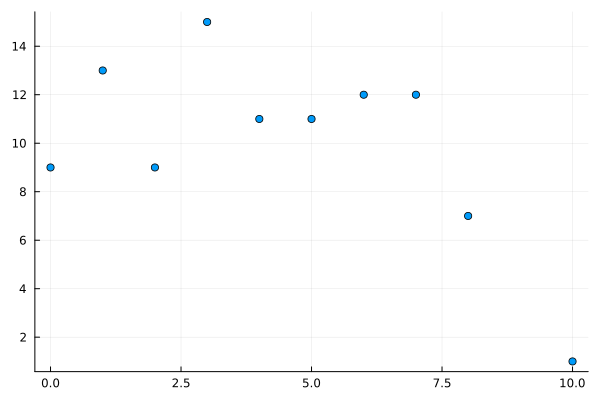

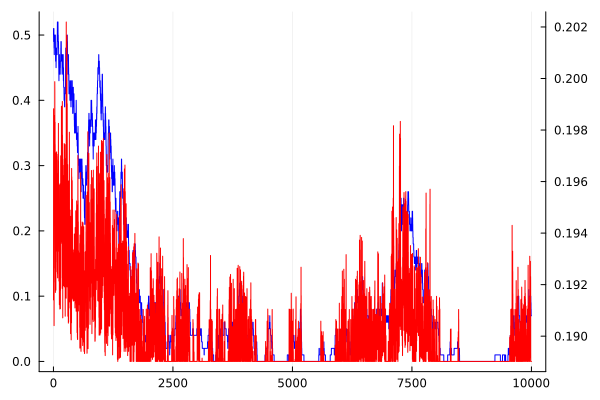

ev_hop: 27, resource_decrement_factor: 0.9
C_rate: 0.012143928035981974
average_resource: 0.18915418597748085
Average Degree (k̄):	 4.0
Average Distance (L):	 3.5429808286951143
Average Clustering Coefficient (C):	 0.04247104247104247


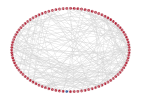

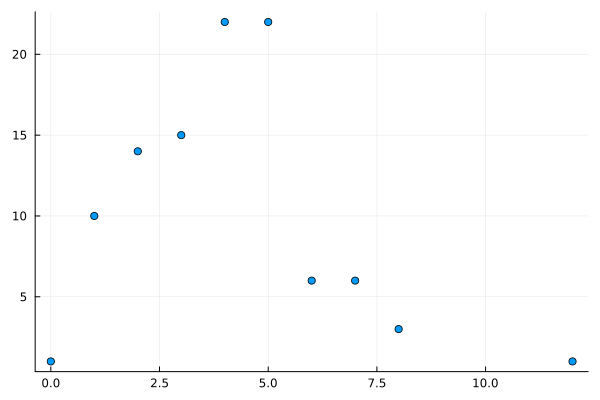

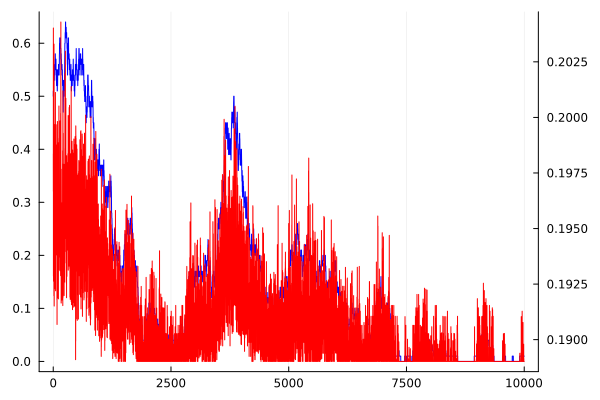

ev_hop: 81, resource_decrement_factor: 0.9
C_rate: 0.05820589705147423
average_resource: 0.18963813404683974
Average Degree (k̄):	 4.0
Average Distance (L):	 3.3776562171260256
Average Clustering Coefficient (C):	 0.06125166444740346


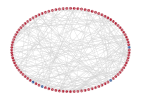

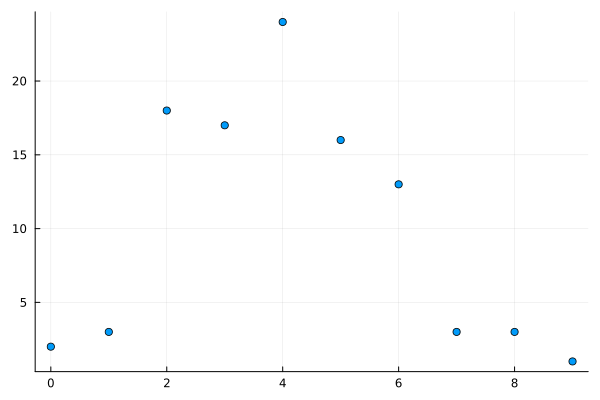

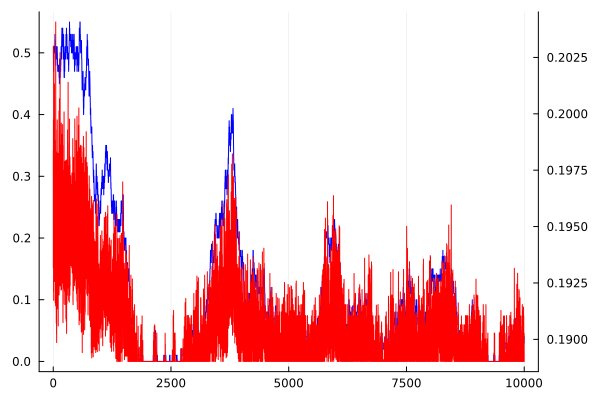

ev_hop: -1, resource_decrement_factor: 0.9
C_rate: 0.207336331834083
average_resource: 0.19136965657663665
Average Degree (k̄):	 4.0
Average Distance (L):	 3.487528344671202
Average Clustering Coefficient (C):	 0.06590621039290241


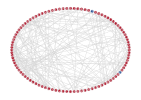

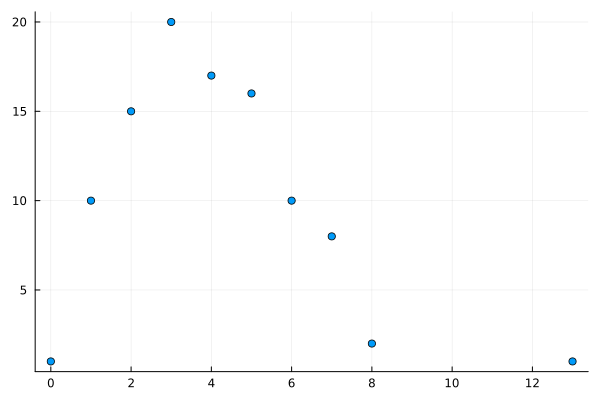

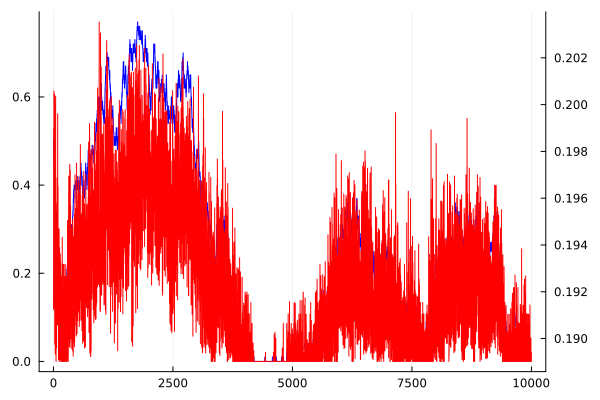

ev_hop: 0, resource_decrement_factor: 1.0
C_rate: 0.00819590204897551
average_resource: 1.0014399380867975
Average Degree (k̄):	 4.0
Average Distance (L):	 3.3930571108622622
Average Clustering Coefficient (C):	 0.056451612903225805


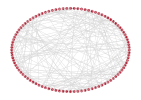

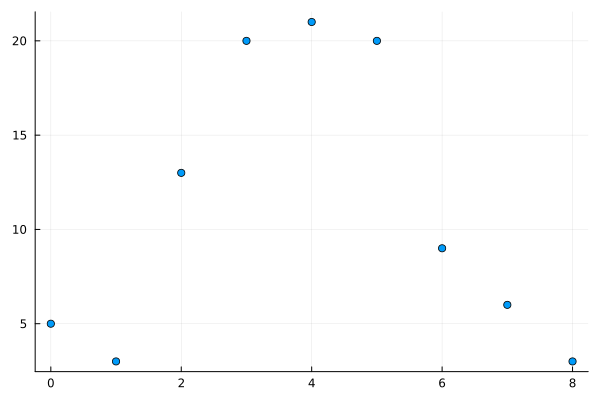

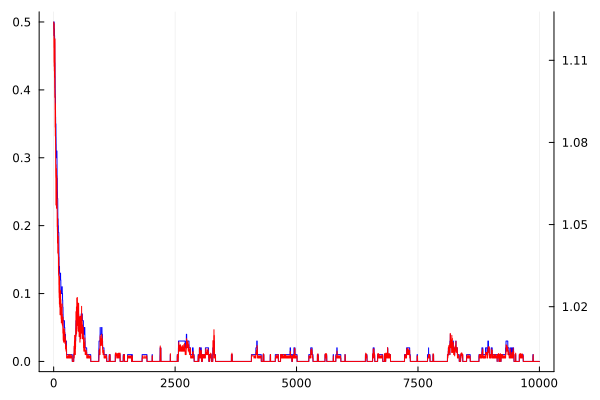

ev_hop: 1, resource_decrement_factor: 1.0
C_rate: 0.007501249375312349
average_resource: 1.001232014150394
Average Degree (k̄):	 4.0
Average Distance (L):	 3.5118872291184515
Average Clustering Coefficient (C):	 0.06640106241699867


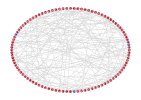

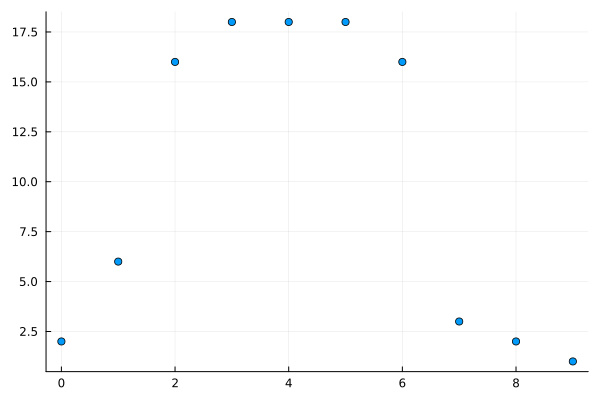

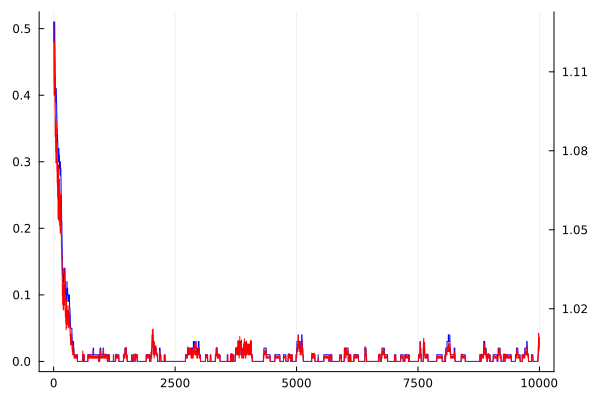

ev_hop: 3, resource_decrement_factor: 1.0
C_rate: 0.008550724637681155
average_resource: 1.001435171219778
Average Degree (k̄):	 4.0
Average Distance (L):	 3.3449561403508774
Average Clustering Coefficient (C):	 0.052429667519181586


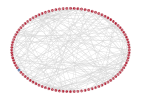

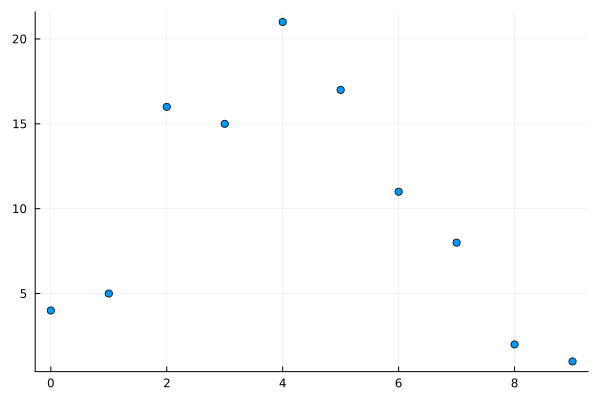

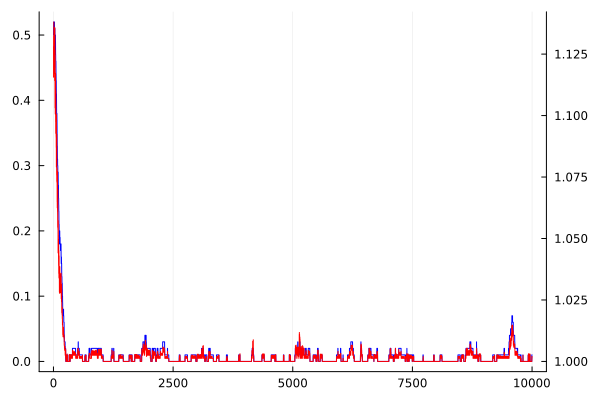

ev_hop: 9, resource_decrement_factor: 1.0
C_rate: 0.00663668165917041
average_resource: 1.001150092985675
Average Degree (k̄):	 4.0
Average Distance (L):	 3.4855056903586
Average Clustering Coefficient (C):	 0.09424724602203183


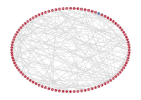

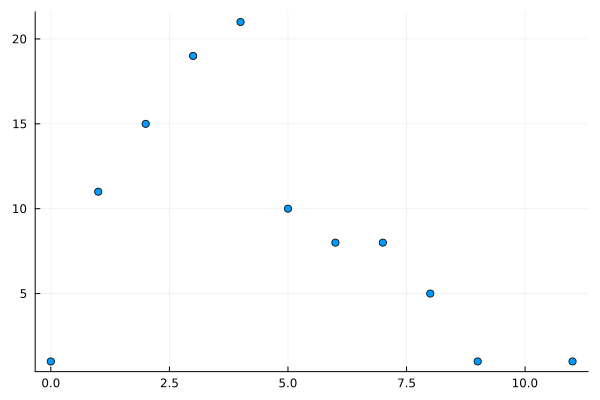

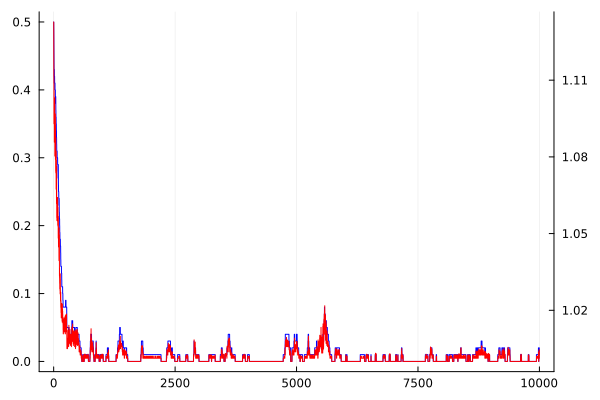

ev_hop: 27, resource_decrement_factor: 1.0
C_rate: 0.004482758620689658
average_resource: 1.0006902194654617
Average Degree (k̄):	 4.0
Average Distance (L):	 3.472929292929293
Average Clustering Coefficient (C):	 0.031047865459249677


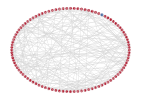

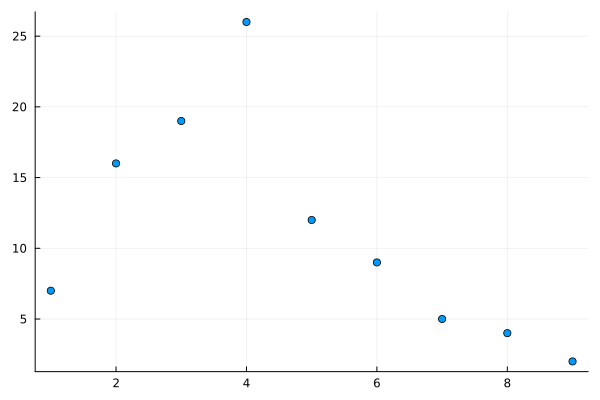

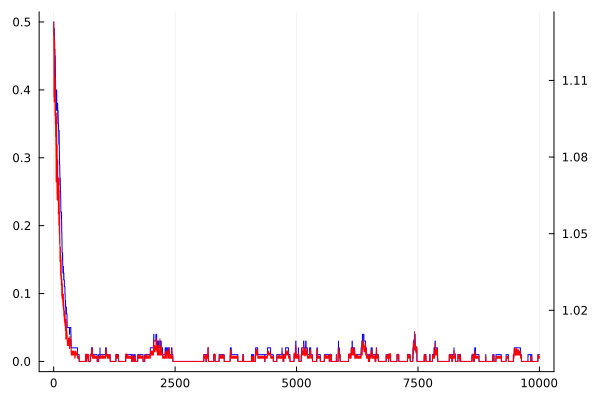

ev_hop: 81, resource_decrement_factor: 1.0
C_rate: 0.005492253873063473
average_resource: 1.0009233118426129
Average Degree (k̄):	 4.0
Average Distance (L):	 3.4375
Average Clustering Coefficient (C):	 0.06084656084656084


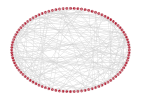

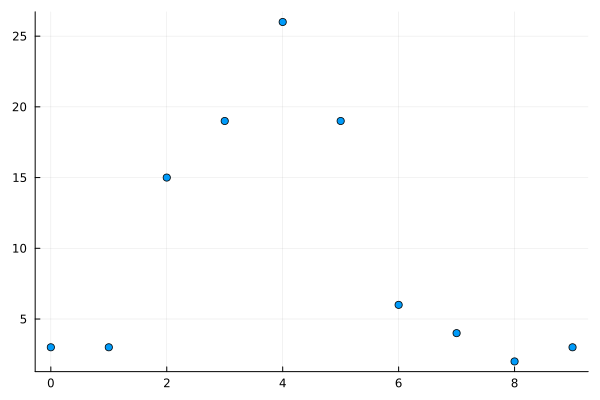

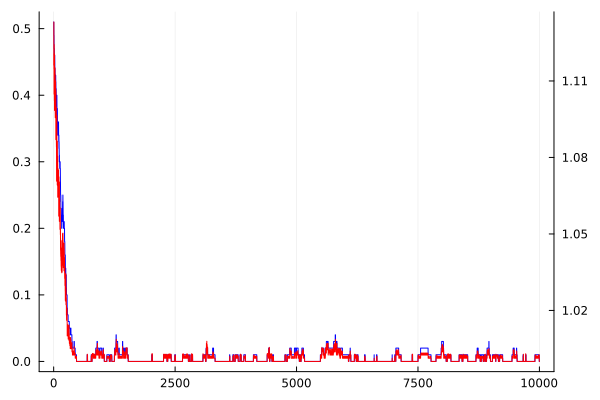

ev_hop: -1, resource_decrement_factor: 1.0
C_rate: 0.00626186906546727
average_resource: 1.0010716475563468
Average Degree (k̄):	 4.0
Average Distance (L):	 3.206638616175783
Average Clustering Coefficient (C):	 0.030037546933667083


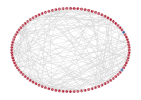

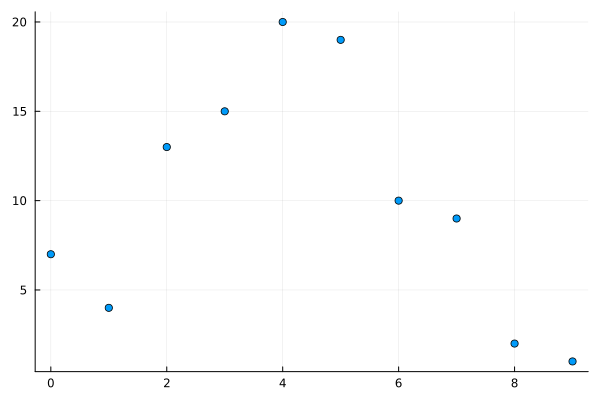

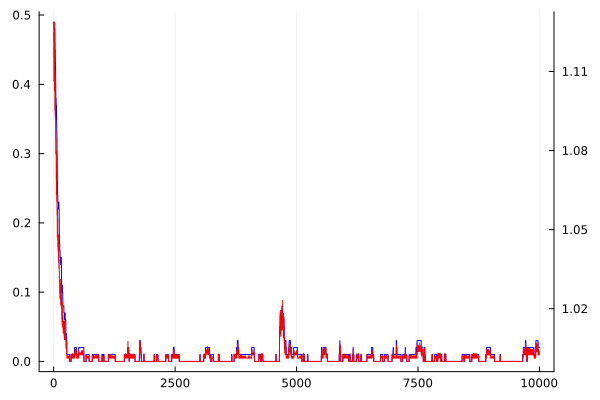

In [11]:
for (ev_hop, resource_decrement_factor) in params
    p = Param(N = 100, k₀ = 4, C_rate₀ = 0.5, generations = 10_000, ev_hop = ev_hop, resource_decrement_factor = resource_decrement_factor)
    m = Model(p)
    C_rate_vec, average_resource_vec = run!(m)
    
    println("ev_hop: $(ev_hop), resource_decrement_factor: $(resource_decrement_factor)")
    println("C_rate: $(mean(C_rate_vec[round(Int, end * 0.8):end]))")
    println("average_resource: $(mean(average_resource_vec[round(Int, end * 0.8):end]))")
    desc(m.g)
    plot_graph(m)
    plot_degree_distribution(m.g)
    
    p = plot(C_rate_vec, label=false, color=:blue)
    plot!(twinx(), average_resource_vec, label=false, color=:red)
    display(p)
end